In [2]:
from google.colab import drive
# drive.mount('/content/drive/')
drive.mount('/content/drive/',force_remount=True)


Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive/


In [3]:
!git clone https://github.com/matterport/Mask_RCNN.git
!pip install -r 'Mask_RCNN/requirements.txt'
!cd Mask_RCNN ; python setup.py install

# Replacing text 'from mrcnn import utils' to 'from Mask_RCNN.mrcnn import utils'

with open('/content/Mask_RCNN/mrcnn/model.py','r') as text_file:
  text = text_file.read()
  text = text.replace('from mrcnn import utils','from Mask_RCNN.mrcnn import utils')
with open('/content/Mask_RCNN/mrcnn/model.py','w') as new_file:
  new_file.write(text)

with open('/content/Mask_RCNN/mrcnn/visualize.py','r') as text_file:
  text = text_file.read()
  text = text.replace('from mrcnn import utils','from Mask_RCNN.mrcnn import utils')
with open('/content/Mask_RCNN/mrcnn/visualize.py','w') as new_file:
  new_file.write(text)

import warnings
warnings.filterwarnings("ignore")

Cloning into 'Mask_RCNN'...
remote: Enumerating objects: 956, done.
remote: Total 956 (delta 0), reused 0 (delta 0), pack-reused 956
Receiving objects: 100% (956/956), 111.84 MiB | 39.22 MiB/s, done.
Resolving deltas: 100% (569/569), done.
     |████████████████████████████████| 204kB 2.9MB/s 
     |████████████████████████████████| 163kB 47.1MB/s 
running install
running bdist_egg
running egg_info
creating mask_rcnn.egg-info
writing mask_rcnn.egg-info/PKG-INFO
writing dependency_links to mask_rcnn.egg-info/dependency_links.txt
writing top-level names to mask_rcnn.egg-info/top_level.txt
writing manifest file 'mask_rcnn.egg-info/SOURCES.txt'
reading manifest template 'MANIFEST.in'
writing manifest file 'mask_rcnn.egg-info/SOURCES.txt'
installing library code to build/bdist.linux-x86_64/egg
running install_lib
running build_py
creating build
creating build/lib
creating build/lib/mrcnn
copying mrcnn/config.py -> build/lib/mrcnn
copying mrcnn/model.py -> build/lib/mrcnn
copying mrcnn/visua

In [4]:
!	pip show mask-rcnn

Name: mask-rcnn
Version: 2.1
Summary: Mask R-CNN for object detection and instance segmentation
Home-page: https://github.com/matterport/Mask_RCNN
Author: Matterport
Author-email: waleed.abdulla@gmail.com
License: MIT
Location: /usr/local/lib/python3.6/dist-packages/mask_rcnn-2.1-py3.6.egg
Requires: 
Required-by: 


In [5]:
# evaluate the mask rcnn model on the TataSky dataset
from os import listdir
from xml.etree import ElementTree
from numpy import zeros
from numpy import asarray
from numpy import expand_dims
from numpy import mean
from Mask_RCNN.mrcnn.config import Config
from Mask_RCNN.mrcnn.model import MaskRCNN
from Mask_RCNN.mrcnn.utils import Dataset
from Mask_RCNN.mrcnn.utils import compute_ap
from Mask_RCNN.mrcnn.model import load_image_gt
import Mask_RCNN.mrcnn.model as modellib
from Mask_RCNN.mrcnn.model import mold_image
from Mask_RCNN.mrcnn.utils import extract_bboxes
from Mask_RCNN.mrcnn.visualize import display_instances
from Mask_RCNN.mrcnn.visualize import display_images
from matplotlib.patches import Rectangle
from matplotlib import pyplot
from google.colab.patches import cv2_imshow #import cv2
from Mask_RCNN.mrcnn.model import log
from Mask_RCNN.mrcnn.visualize import display_differences
from matplotlib import pyplot

import os
import random
import pickle
import warnings
warnings.filterwarnings('ignore')

Using TensorFlow backend.


In [0]:
# variable assignments
xml_path = '/content/drive/My Drive/Colab Notebooks/Task_Assign/TTsky/Train/annots/TV_Recording_Sample_2 009.xml'

(2160, 3840, 3)
xmin, ymin, xmax, ymax 733 1554 1031 1623
load mask function - boxes : 1
box[0], box[1], box[2], box[3]  733 1554 1031 1623
row_s, row_e,col_s, col_e 1554 1623 733 1031
load mask function - masks :- (2160, 3840, 1)
load mask function - class_ids :- [1]
(2160, 3840, 1)


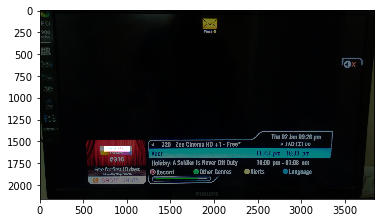

In [8]:
# plot one photograph and mask

# class that defines and loads the TataSky dataset
class TTSkyDataset(Dataset):
	# load the dataset definitions
	def load_dataset(self, dataset_dir, is_train=True):
		# define one class
		self.add_class("dataset", 1, "TTSky")
		# define data locations
		images_dir = dataset_dir + '/images/'
		annotations_dir = dataset_dir + '/annots/'
		# find all images
		for filename in listdir(images_dir):
			# extract image id
			image_id = filename[:-4]
			# skip bad images
			# if image_id in ['00090']:
			# 	continue
			# skip all images after 150 if we are building the train set
			# if is_train and int(image_id) >= 180:
			# 	continue
			# # skip all images before 150 if we are building the test/val set
			# if not is_train and int(image_id) < 180:
			# 	continue
			img_path = images_dir + filename
			ann_path = annotations_dir + image_id + '.xml'
			# add to dataset
			self.add_image('dataset', image_id=image_id, path=img_path, annotation=ann_path)

	# extract bounding boxes from an annotation file
	def extract_boxes(self, filename):
		# load and parse the file
		tree = ElementTree.parse(filename)
		# get the root of the document
		root = tree.getroot()
		# extract each bounding box
		boxes = list()
		for box in root.findall('.//bndbox'):
			xmin = int(box.find('xmin').text)
			ymin = int(box.find('ymin').text)
			xmax = int(box.find('xmax').text)
			ymax = int(box.find('ymax').text)
			coors = [xmin, ymin, xmax, ymax]
			print('xmin, ymin, xmax, ymax',xmin, ymin, xmax, ymax)
			boxes.append(coors)
		# extract image dimensions
		width = int(root.find('.//size/width').text)
		height = int(root.find('.//size/height').text)
		return boxes, width, height

	# load the masks for an image
	def load_mask(self, image_id):
		# get details of image
		info = self.image_info[image_id]
		# define box file location
		path = info['annotation']
		# load XML
		boxes, w, h = self.extract_boxes(path)
		print('load mask function - boxes :',len(boxes))
		# create one array for all masks, each on a different channel
		masks = zeros([h, w, len(boxes)], dtype='uint8')
		# create masks
		class_ids = list()
		for i in range(len(boxes)):
			box = boxes[i]
			print('box[0], box[1], box[2], box[3] ',box[0],box[1], box[2], box[3])
			row_s, row_e = box[1], box[3]
			col_s, col_e = box[0], box[2]
			print('row_s, row_e,col_s, col_e',row_s, row_e,col_s, col_e)
			masks[row_s:row_e, col_s:col_e, i] = 1
			class_ids.append(self.class_names.index('TTSky'))
			print('load mask function - masks :-',masks.shape)
			print('load mask function - class_ids :-',class_ids)
		return masks, asarray(class_ids, dtype='int32')

	# load an image reference
	def image_reference(self, image_id):
		info = self.image_info[image_id]
		return info['path']

train_ref_path = '/content/drive/My Drive/Colab Notebooks/Task_Assign/TTsky/Train'
test_ref_path =  '/content/drive/My Drive/Colab Notebooks/Task_Assign/TTsky/Test'

# train set
train_set = TTSkyDataset()
train_set.load_dataset(train_ref_path, is_train=True)
train_set.prepare()
# load an image
image_id = 0
image = train_set.load_image(image_id)
print(image.shape)
# load image mask
mask, class_ids = train_set.load_mask(image_id)
print(mask.shape)
# plot image
pyplot.imshow(image)
# plot mask
pyplot.imshow(mask[:, :, 0], cmap='gray', alpha=0.5)
pyplot.show()

In [0]:
# fit a mask rcnn on the TataSky dataset


# class that defines and loads the TataSky dataset
class TTSkyDataset(Dataset):
	# load the dataset definitions
	def load_dataset(self, dataset_dir, is_train=True):
		# define one class
		self.add_class("dataset", 1, "TTSky")
		# define data locations
		images_dir = dataset_dir + '/images/'
		annotations_dir = dataset_dir + '/annots/'
		# find all images
		for filename in listdir(images_dir):
			# extract image id
			image_id = filename[:-4]
			# skip bad images
			# if image_id in ['00011']:
			# 	continue
			# skip all images after 150 if we are building the train set
			# if is_train and int(image_id) >= 185:
			# 	continue
			# # skip all images before 150 if we are building the test/val set
			# if not is_train and int(image_id) < 185:
			# 	continue
			img_path = images_dir + filename
			ann_path = annotations_dir + image_id + '.xml'
			# add to dataset
			self.add_image('dataset', image_id=image_id, path=img_path, annotation=ann_path)

	# extract bounding boxes from an annotation file
	def extract_boxes(self, filename):
		# load and parse the file
		tree = ElementTree.parse(filename)
		# get the root of the document
		root = tree.getroot()
		# extract each bounding box
		boxes = list()
		for box in root.findall('.//bndbox'):
			xmin = int(box.find('xmin').text)
			ymin = int(box.find('ymin').text)
			xmax = int(box.find('xmax').text)
			ymax = int(box.find('ymax').text)
			coors = [xmin, ymin, xmax, ymax]
			boxes.append(coors)
		# extract image dimensions
		width = int(root.find('.//size/width').text)
		height = int(root.find('.//size/height').text)
		return boxes, width, height

	# load the masks for an image
	def load_mask(self, image_id):
		# get details of image
		info = self.image_info[image_id]
		# define box file location
		path = info['annotation']
		# load XML
		boxes, w, h = self.extract_boxes(path)
		# create one array for all masks, each on a different channel
		masks = zeros([h, w, len(boxes)], dtype='uint8')
		# create masks
		class_ids = list()
		for i in range(len(boxes)):
			box = boxes[i]
			row_s, row_e = box[1], box[3]
			col_s, col_e = box[0], box[2]
			masks[row_s:row_e, col_s:col_e, i] = 1
			class_ids.append(self.class_names.index('TTSky'))
		return masks, asarray(class_ids, dtype='int32')

	# load an image reference
	def image_reference(self, image_id):
		info = self.image_info[image_id]
		return info['path']

# define a configuration for the model
class TTSkyConfig(Config):
	# define the name of the configuration
	NAME = "TTSky_cfg"
	# number of classes (background + TTSkyDataset)
	NUM_CLASSES = 1 + 1
	# number of training steps per epoch
	STEPS_PER_EPOCH = 100

train_ref_path = '/content/drive/My Drive/Colab Notebooks/Task_Assign/TTsky/Train'
test_ref_path =  '/content/drive/My Drive/Colab Notebooks/Task_Assign/TTsky/Test'

# prepare train set
train_set = TTSkyDataset()
train_set.load_dataset(train_ref_path, is_train=True)
train_set.prepare()
print('Train: %d' % len(train_set.image_ids))
# prepare test/val set
test_set = TTSkyDataset()
test_set.load_dataset(test_ref_path, is_train=False)
test_set.prepare()
print('Test: %d' % len(test_set.image_ids))
# prepare config
config = TTSkyConfig()
# config.display()
# define the model
model = MaskRCNN(mode='training', model_dir='./', config=config)
# load weights (mscoco) and exclude the output layers
pretrained_model_path = '/content/drive/My Drive/Colab Notebooks/mask_rcnn_coco.h5'
model.load_weights(pretrained_model_path, by_name=True, exclude=["mrcnn_class_logits", "mrcnn_bbox_fc",  "mrcnn_bbox", "mrcnn_mask"])
# train weights (output layers or 'heads','all')
# pay attention to the loss for the classification output on the train and validation datasets (e.g. mrcnn_class_loss and val_mrcnn_class_loss), 
# and loss for the bounding box output for the train and validation datasets (mrcnn_bbox_loss and val_mrcnn_bbox_loss).

model.train(train_set, test_set, learning_rate=0.001, epochs=200, layers='all') #layers='heads'


Using TensorFlow backend.


Train: 172
Test: 19






Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


Instructions for updating:
box_ind is deprecated, use box_indices instead







Starting at epoch 0. LR=0.001

Checkpoint Path: ./ttsky_cfg20200210T0614/mask_rcnn_ttsky_cfg_{epoch:04d}.h5
Selecting layers to train
conv1                  (Conv2D)
bn_conv1               (BatchNorm)
res2a_branch2a         (Conv2D)
bn2a_branch2a          (BatchNorm)
res2a_branch2b         (Conv2D)
bn2a_branch2b          (BatchNorm)
res2a_branch2c         (Conv2D)
res2a_branch1          (Conv2D)
bn2a_branch2c          (BatchNorm)
bn2a_branch1           (BatchNorm)
res2b_branch2a         (Conv2D)
bn2b_branch2a          (BatchNorm)
res2b_branch2b         (Conv2D)
bn2b_branch2b          (BatchNorm)
res2b_branch2c         (Conv2D)
bn2b_branch2c          (BatchNorm)
res2c_branch2a         (Conv2D)
bn2c_branch2a          (BatchNorm)
res2c_branch2b         (Conv2D)
bn2c_branch2b          (Batc

Process ForkPoolWorker-7:
Process ForkPoolWorker-1:
Process ForkPoolWorker-2:
Process ForkPoolWorker-5:
Process ForkPoolWorker-6:
Traceback (most recent call last):
Process ForkPoolWorker-8:
Traceback (most recent call last):
Traceback (most recent call last):
  File "/usr/lib/python3.6/multiprocessing/process.py", line 258, in _bootstrap
    self.run()
Traceback (most recent call last):
Traceback (most recent call last):
  File "/usr/lib/python3.6/multiprocessing/process.py", line 258, in _bootstrap
    self.run()
Process ForkPoolWorker-3:
Traceback (most recent call last):
  File "/usr/lib/python3.6/multiprocessing/process.py", line 93, in run
    self._target(*self._args, **self._kwargs)
  File "/usr/lib/python3.6/multiprocessing/process.py", line 258, in _bootstrap
    self.run()
  File "/usr/lib/python3.6/multiprocessing/process.py", line 258, in _bootstrap
    self.run()
  File "/usr/lib/python3.6/multiprocessing/process.py", line 93, in run
    self._target(*self._args, **self._

KeyboardInterrupt: ignored

Test: 19
Re-starting from epoch 150
test image info {'id': 'TV_Recording_Sample_2 102', 'source': 'dataset', 'path': '/content/drive/My Drive/Colab Notebooks/Task_Assign/TTsky/Test/images/TV_Recording_Sample_2 102.jpg', 'annotation': '/content/drive/My Drive/Colab Notebooks/Task_Assign/TTsky/Test/annots/TV_Recording_Sample_2 102.xml'}
test image_id :- 0


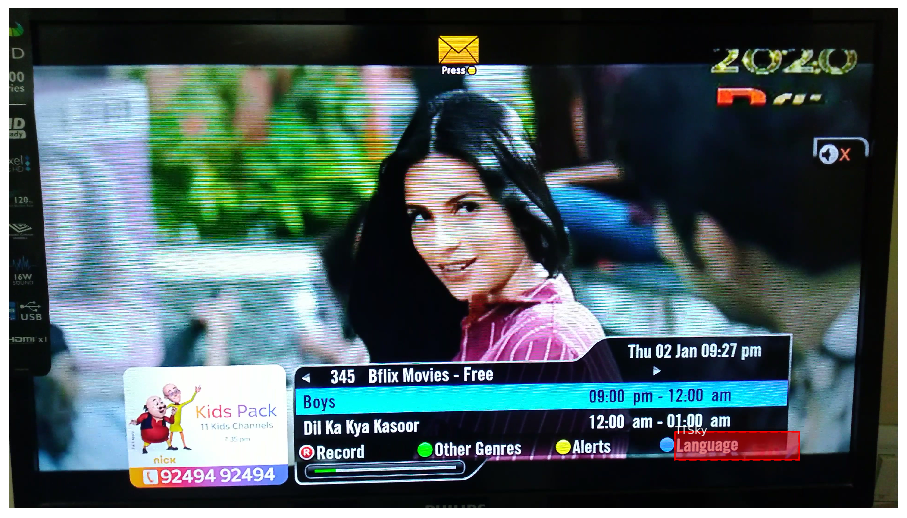

test image info {'id': 'TV_Recording_Sample_2 106', 'source': 'dataset', 'path': '/content/drive/My Drive/Colab Notebooks/Task_Assign/TTsky/Test/images/TV_Recording_Sample_2 106.jpg', 'annotation': '/content/drive/My Drive/Colab Notebooks/Task_Assign/TTsky/Test/annots/TV_Recording_Sample_2 106.xml'}
test image_id :- 1


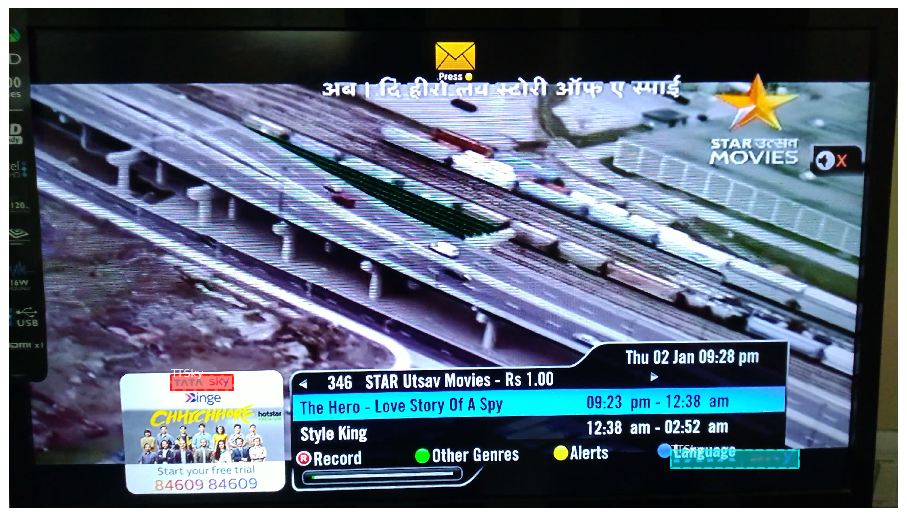

test image info {'id': 'TV_Recording_Sample_2 114', 'source': 'dataset', 'path': '/content/drive/My Drive/Colab Notebooks/Task_Assign/TTsky/Test/images/TV_Recording_Sample_2 114.jpg', 'annotation': '/content/drive/My Drive/Colab Notebooks/Task_Assign/TTsky/Test/annots/TV_Recording_Sample_2 114.xml'}
test image_id :- 2


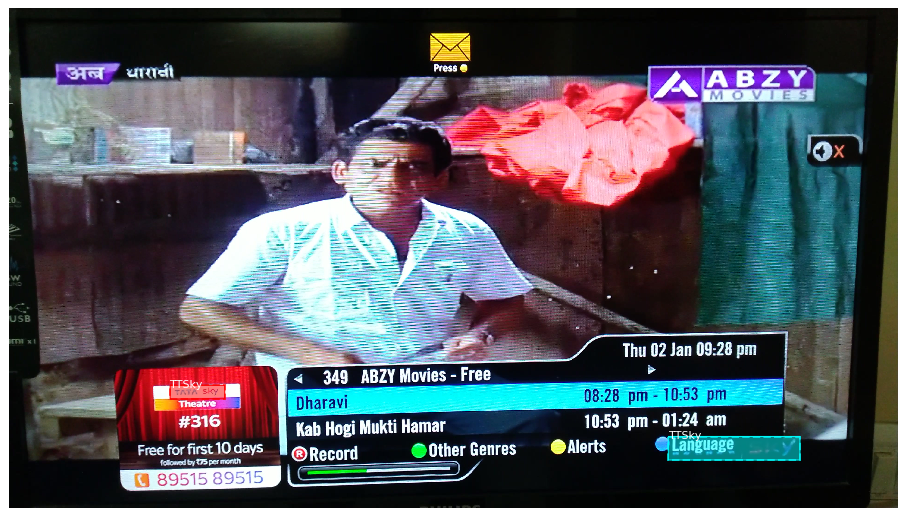

test image info {'id': 'TV_Recording_Sample_2 115', 'source': 'dataset', 'path': '/content/drive/My Drive/Colab Notebooks/Task_Assign/TTsky/Test/images/TV_Recording_Sample_2 115.jpg', 'annotation': '/content/drive/My Drive/Colab Notebooks/Task_Assign/TTsky/Test/annots/TV_Recording_Sample_2 115.xml'}
test image_id :- 3


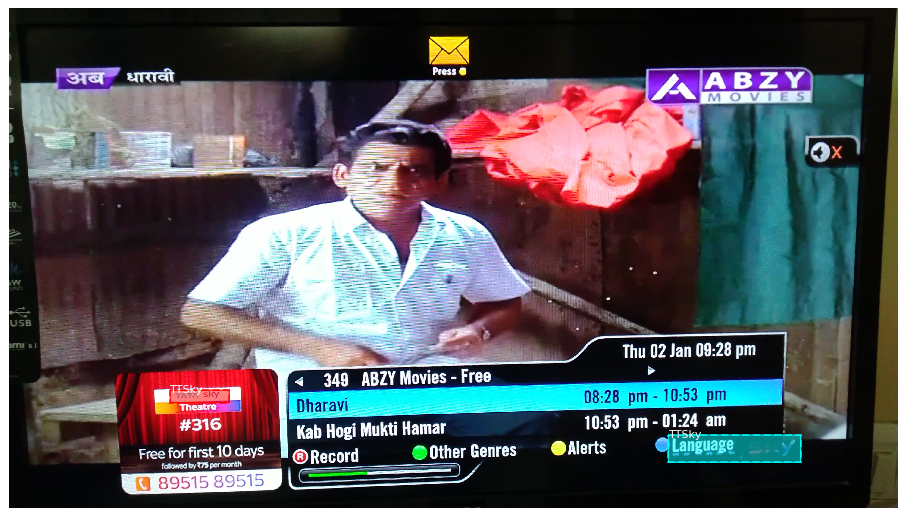

test image info {'id': 'TV_Recording_Sample_2 113', 'source': 'dataset', 'path': '/content/drive/My Drive/Colab Notebooks/Task_Assign/TTsky/Test/images/TV_Recording_Sample_2 113.jpg', 'annotation': '/content/drive/My Drive/Colab Notebooks/Task_Assign/TTsky/Test/annots/TV_Recording_Sample_2 113.xml'}
test image_id :- 4


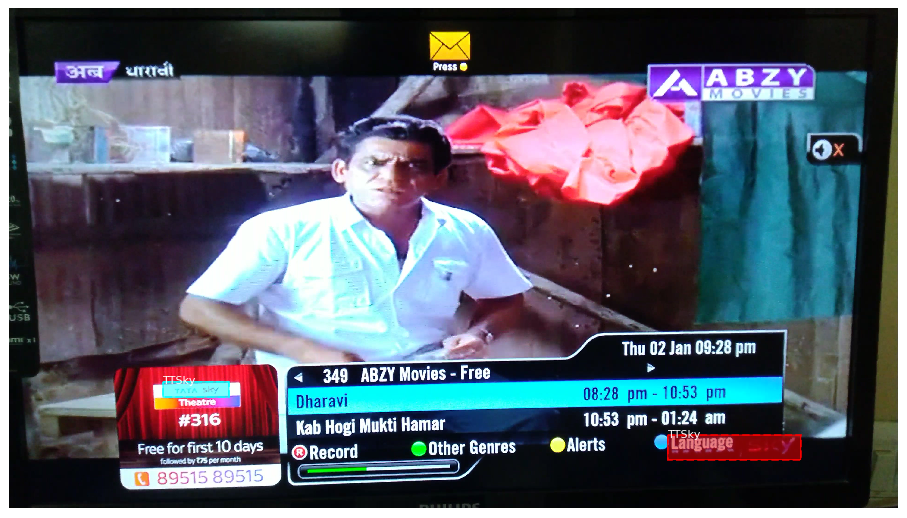

test image info {'id': 'TV_Recording_Sample_3 0001', 'source': 'dataset', 'path': '/content/drive/My Drive/Colab Notebooks/Task_Assign/TTsky/Test/images/TV_Recording_Sample_3 0001.jpg', 'annotation': '/content/drive/My Drive/Colab Notebooks/Task_Assign/TTsky/Test/annots/TV_Recording_Sample_3 0001.xml'}
test image_id :- 5


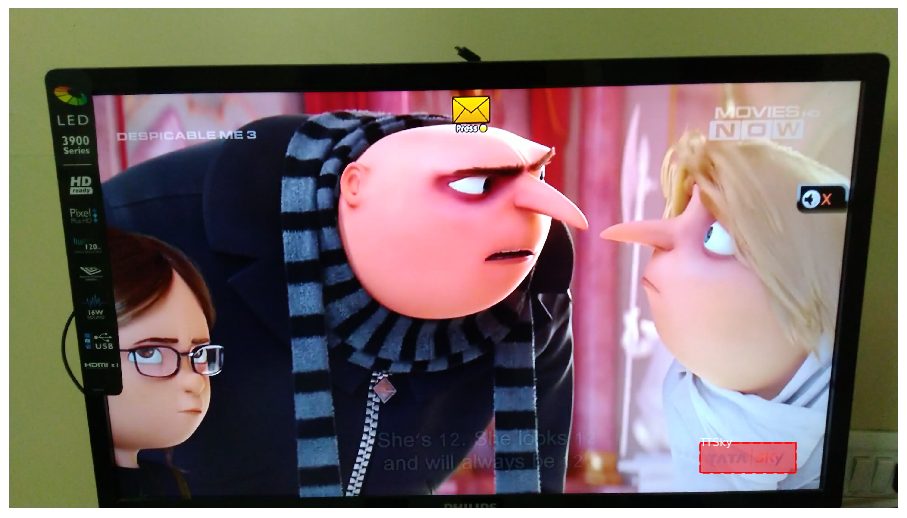

test image info {'id': 'TV_Recording_Sample_3 0004', 'source': 'dataset', 'path': '/content/drive/My Drive/Colab Notebooks/Task_Assign/TTsky/Test/images/TV_Recording_Sample_3 0004.jpg', 'annotation': '/content/drive/My Drive/Colab Notebooks/Task_Assign/TTsky/Test/annots/TV_Recording_Sample_3 0004.xml'}
test image_id :- 6


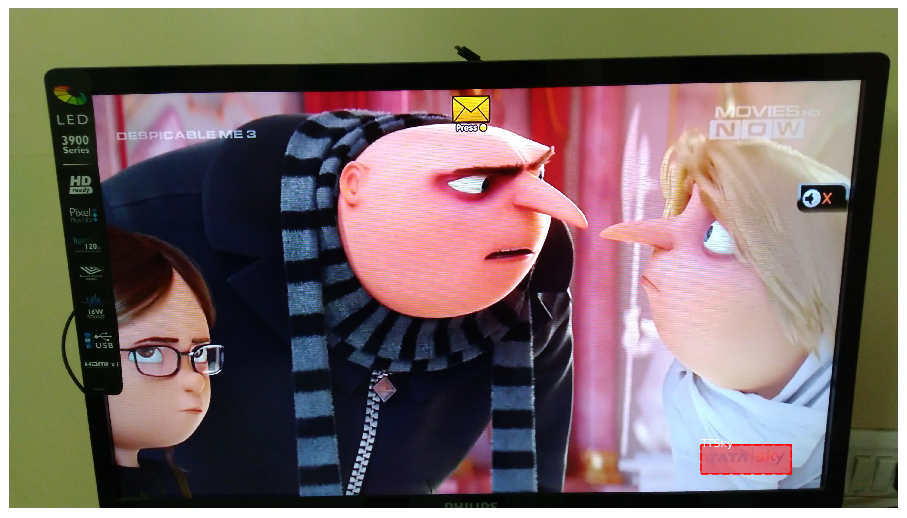

test image info {'id': 'TV_Recording_Sample_3 0002', 'source': 'dataset', 'path': '/content/drive/My Drive/Colab Notebooks/Task_Assign/TTsky/Test/images/TV_Recording_Sample_3 0002.jpg', 'annotation': '/content/drive/My Drive/Colab Notebooks/Task_Assign/TTsky/Test/annots/TV_Recording_Sample_3 0002.xml'}
test image_id :- 7


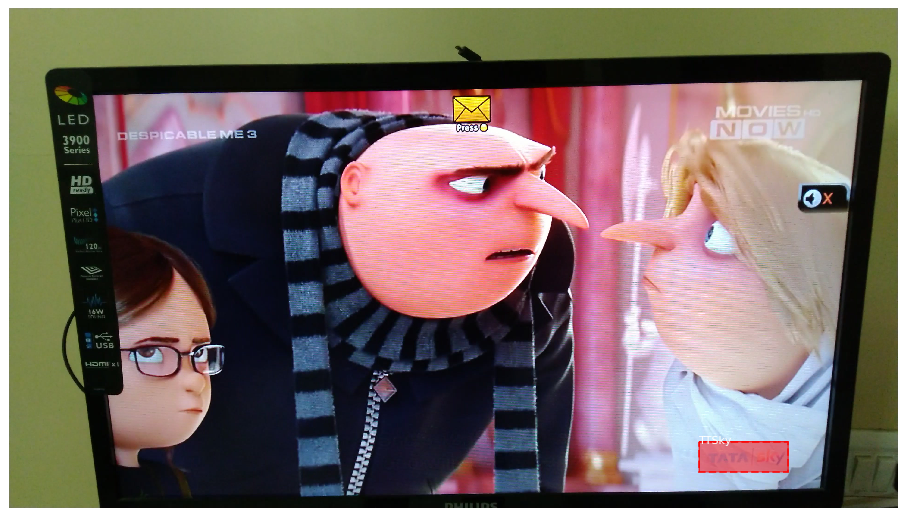

test image info {'id': 'TV_Recording_Sample_3 0003', 'source': 'dataset', 'path': '/content/drive/My Drive/Colab Notebooks/Task_Assign/TTsky/Test/images/TV_Recording_Sample_3 0003.jpg', 'annotation': '/content/drive/My Drive/Colab Notebooks/Task_Assign/TTsky/Test/annots/TV_Recording_Sample_3 0003.xml'}
test image_id :- 8


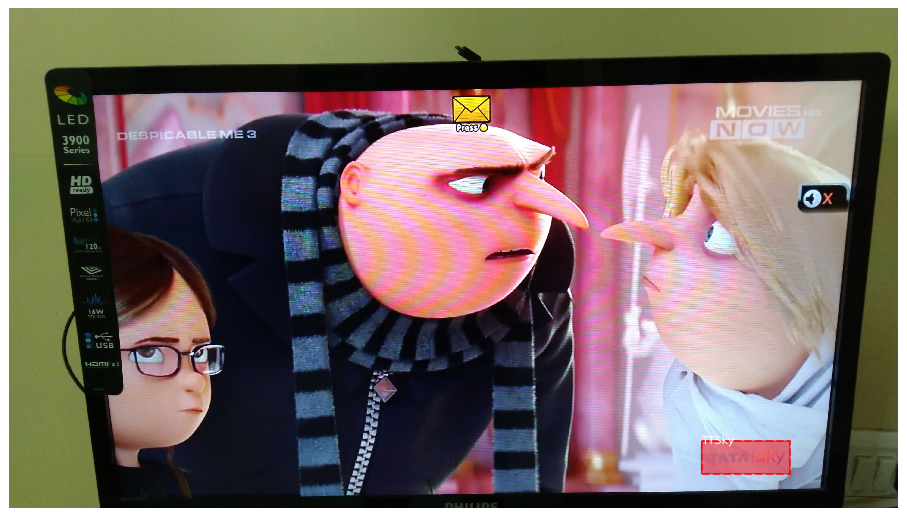

test image info {'id': 'TV_Recording_Sample_3 0251', 'source': 'dataset', 'path': '/content/drive/My Drive/Colab Notebooks/Task_Assign/TTsky/Test/images/TV_Recording_Sample_3 0251.jpg', 'annotation': '/content/drive/My Drive/Colab Notebooks/Task_Assign/TTsky/Test/annots/TV_Recording_Sample_3 0251.xml'}
test image_id :- 9


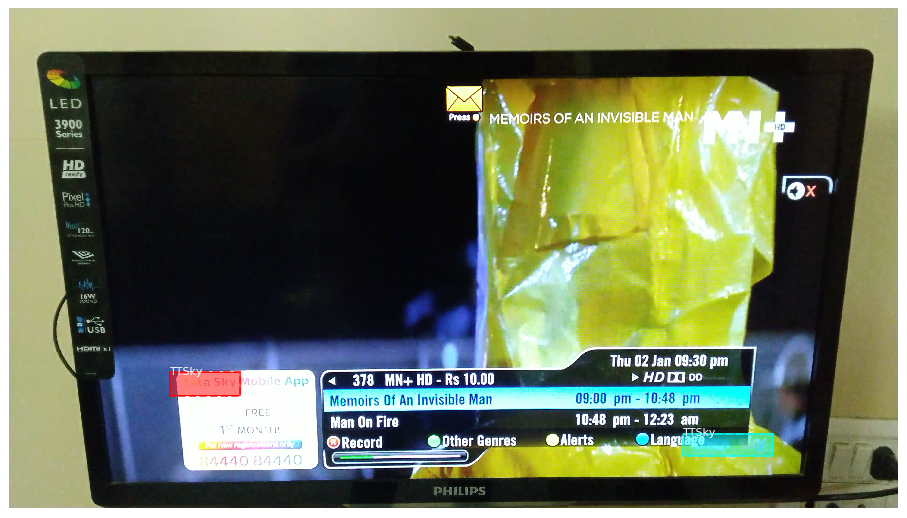

test image info {'id': 'TV_Recording_Sample_3 0250', 'source': 'dataset', 'path': '/content/drive/My Drive/Colab Notebooks/Task_Assign/TTsky/Test/images/TV_Recording_Sample_3 0250.jpg', 'annotation': '/content/drive/My Drive/Colab Notebooks/Task_Assign/TTsky/Test/annots/TV_Recording_Sample_3 0250.xml'}
test image_id :- 10


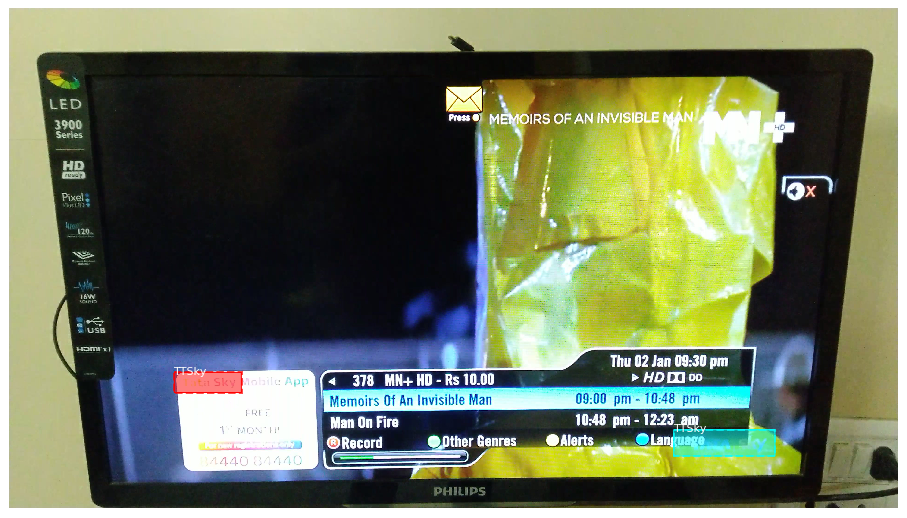

test image info {'id': 'TV_Recording_Sample_3 0252', 'source': 'dataset', 'path': '/content/drive/My Drive/Colab Notebooks/Task_Assign/TTsky/Test/images/TV_Recording_Sample_3 0252.jpg', 'annotation': '/content/drive/My Drive/Colab Notebooks/Task_Assign/TTsky/Test/annots/TV_Recording_Sample_3 0252.xml'}
test image_id :- 11


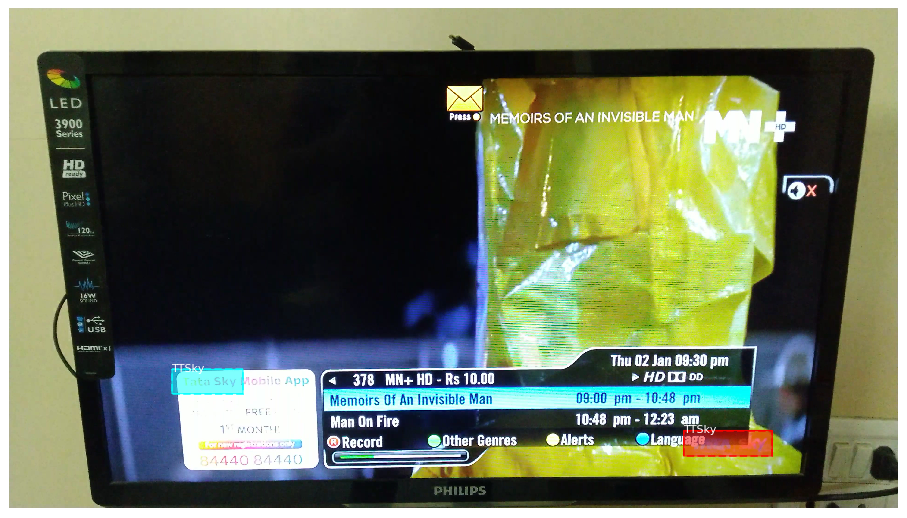

test image info {'id': 'TV_Recording_Sample_3 0270', 'source': 'dataset', 'path': '/content/drive/My Drive/Colab Notebooks/Task_Assign/TTsky/Test/images/TV_Recording_Sample_3 0270.jpg', 'annotation': '/content/drive/My Drive/Colab Notebooks/Task_Assign/TTsky/Test/annots/TV_Recording_Sample_3 0270.xml'}
test image_id :- 12


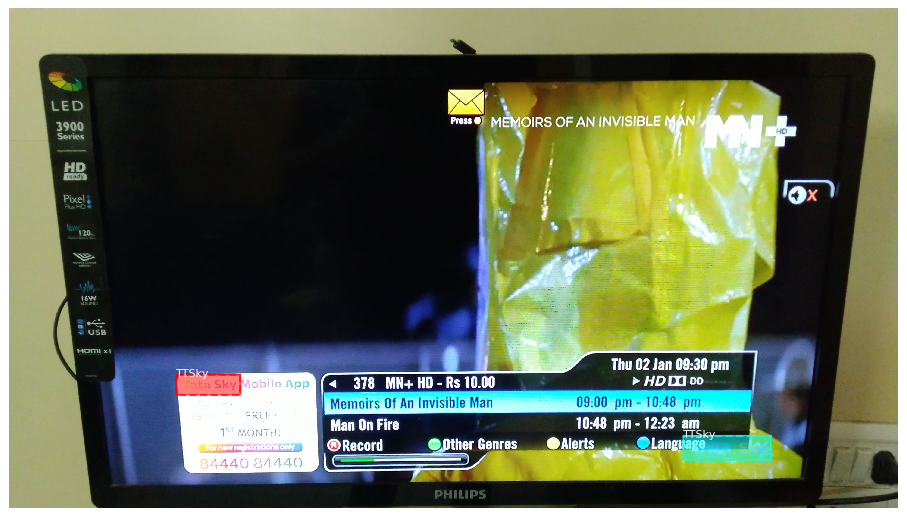

test image info {'id': 'TV_Recording_Sample_3 0272', 'source': 'dataset', 'path': '/content/drive/My Drive/Colab Notebooks/Task_Assign/TTsky/Test/images/TV_Recording_Sample_3 0272.jpg', 'annotation': '/content/drive/My Drive/Colab Notebooks/Task_Assign/TTsky/Test/annots/TV_Recording_Sample_3 0272.xml'}
test image_id :- 13


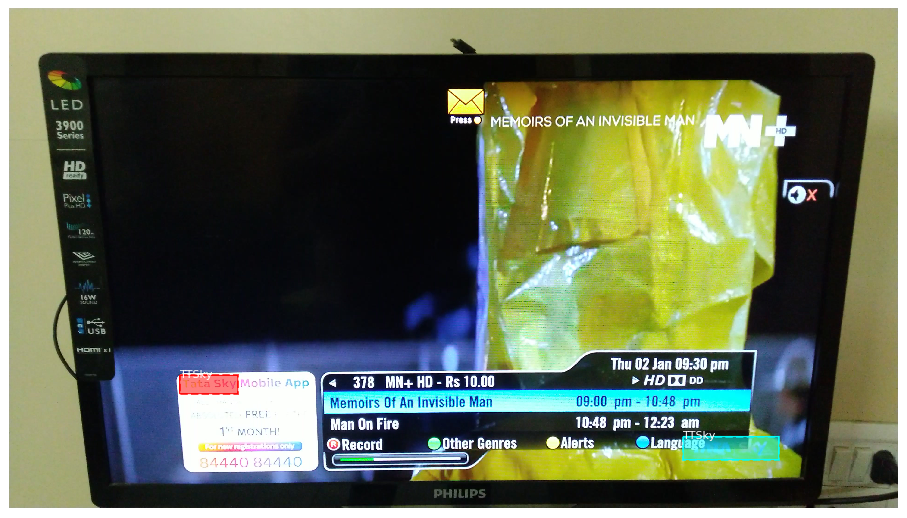

test image info {'id': 'TV_Recording_Sample_3 0271', 'source': 'dataset', 'path': '/content/drive/My Drive/Colab Notebooks/Task_Assign/TTsky/Test/images/TV_Recording_Sample_3 0271.jpg', 'annotation': '/content/drive/My Drive/Colab Notebooks/Task_Assign/TTsky/Test/annots/TV_Recording_Sample_3 0271.xml'}
test image_id :- 14


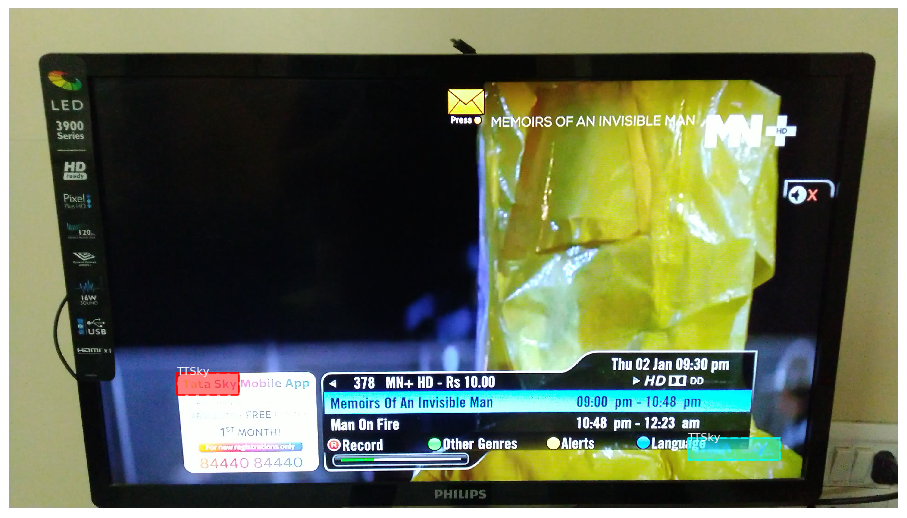

test image info {'id': 'TV_Recording_Sample_3 0297', 'source': 'dataset', 'path': '/content/drive/My Drive/Colab Notebooks/Task_Assign/TTsky/Test/images/TV_Recording_Sample_3 0297.jpg', 'annotation': '/content/drive/My Drive/Colab Notebooks/Task_Assign/TTsky/Test/annots/TV_Recording_Sample_3 0297.xml'}
test image_id :- 15


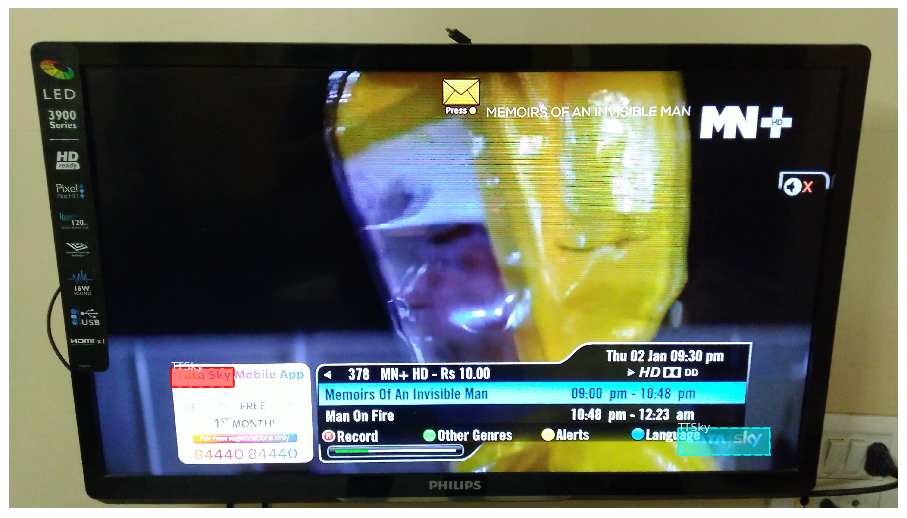

test image info {'id': 'TV_Recording_Sample_3 0298', 'source': 'dataset', 'path': '/content/drive/My Drive/Colab Notebooks/Task_Assign/TTsky/Test/images/TV_Recording_Sample_3 0298.jpg', 'annotation': '/content/drive/My Drive/Colab Notebooks/Task_Assign/TTsky/Test/annots/TV_Recording_Sample_3 0298.xml'}
test image_id :- 16


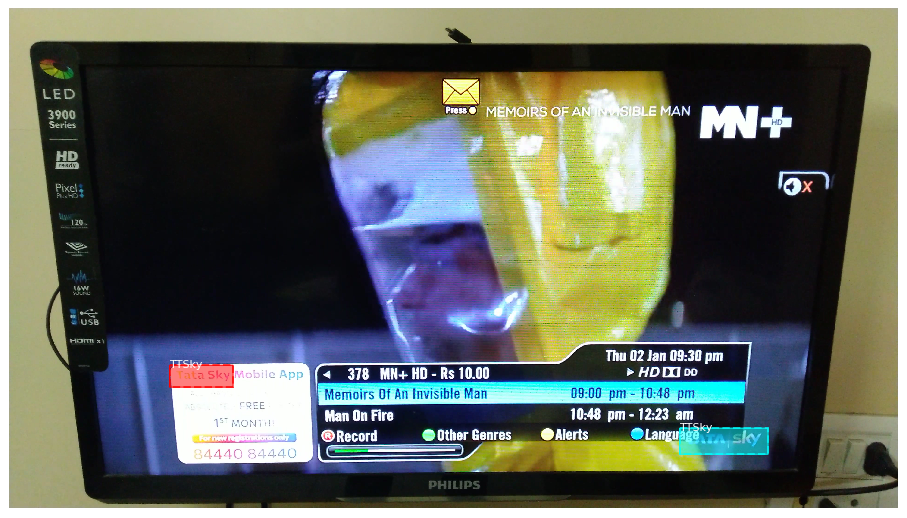

test image info {'id': 'TV_Recording_Sample_3 0299', 'source': 'dataset', 'path': '/content/drive/My Drive/Colab Notebooks/Task_Assign/TTsky/Test/images/TV_Recording_Sample_3 0299.jpg', 'annotation': '/content/drive/My Drive/Colab Notebooks/Task_Assign/TTsky/Test/annots/TV_Recording_Sample_3 0299.xml'}
test image_id :- 17


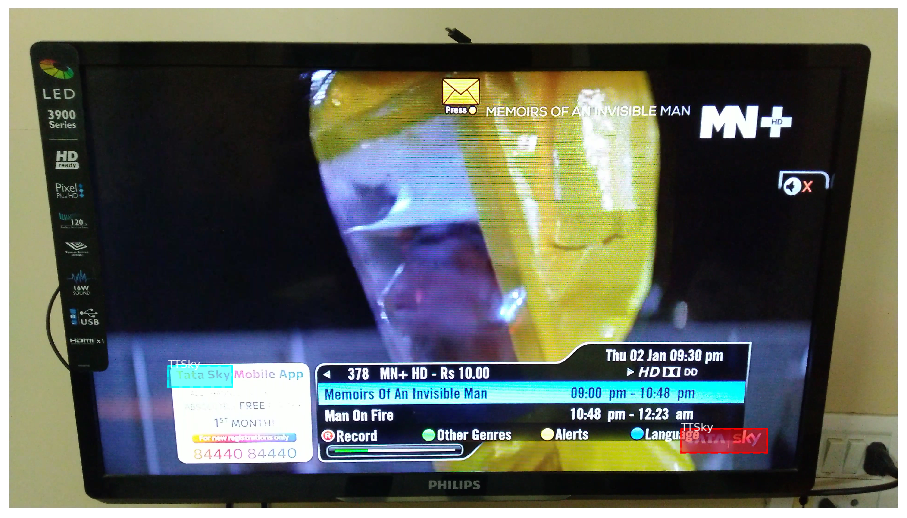

test image info {'id': 'TV_Recording_Sample_3 0300', 'source': 'dataset', 'path': '/content/drive/My Drive/Colab Notebooks/Task_Assign/TTsky/Test/images/TV_Recording_Sample_3 0300.jpg', 'annotation': '/content/drive/My Drive/Colab Notebooks/Task_Assign/TTsky/Test/annots/TV_Recording_Sample_3 0300.xml'}
test image_id :- 18


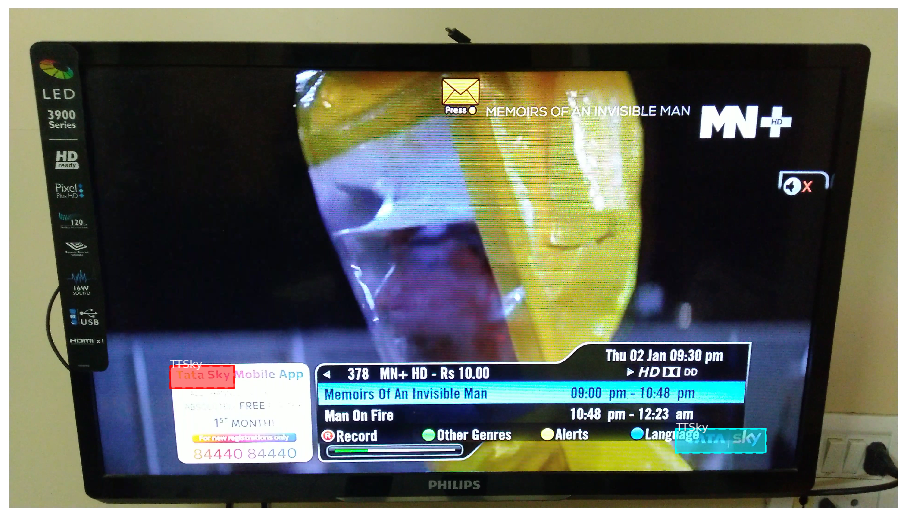

Test mAP: 0.947


In [0]:


# class that defines and loads the TataSky dataset
class TTSkyDataset(Dataset):
	# load the dataset definitions
	def load_dataset(self, dataset_dir, is_train=True):
		# define one class
		self.add_class("dataset", 1, "TTSky")
		# define data locations
		images_dir = dataset_dir + '/images/'
		annotations_dir = dataset_dir + '/annots/'
		# find all images
		for filename in listdir(images_dir):
			# extract image id
			image_id = filename[:-4]
			img_path = images_dir + filename
			ann_path = annotations_dir + image_id + '.xml'
			# add to dataset
			self.add_image('dataset', image_id=image_id, path=img_path, annotation=ann_path)

	# extract bounding boxes from an annotation file
	def extract_boxes(self, filename):
		# load and parse the file
		tree = ElementTree.parse(filename)
		# get the root of the document
		root = tree.getroot()
		# extract each bounding box
		boxes = list()
		for box in root.findall('.//bndbox'):
			xmin = int(box.find('xmin').text)
			ymin = int(box.find('ymin').text)
			xmax = int(box.find('xmax').text)
			ymax = int(box.find('ymax').text)
			coors = [xmin, ymin, xmax, ymax]
			boxes.append(coors)
		# extract image dimensions
		width = int(root.find('.//size/width').text)
		height = int(root.find('.//size/height').text)
		return boxes, width, height

	# load the masks for an image
	def load_mask(self, image_id):		
		# get details of image
		info = self.image_info[image_id]
		# define box file location
		path = info['annotation']
		# load XML
		boxes, w, h = self.extract_boxes(path)
		# create one array for all masks, each on a different channel
		masks = zeros([h, w, len(boxes)], dtype='uint8')
		# create masks
		class_ids = list()
		for i in range(len(boxes)):
			box = boxes[i]
			row_s, row_e = box[1], box[3]
			col_s, col_e = box[0], box[2]
			masks[row_s:row_e, col_s:col_e, i] = 1
			class_ids.append(self.class_names.index('TTSky'))
		return masks, asarray(class_ids, dtype='int32')

	# load an image reference
	def image_reference(self, image_id):
		info = self.image_info[image_id]
		return info['path']

# define the prediction configuration
class TTSkyConfig(Config):
	# define the name of the configuration
	NAME = "TTSky_cfg"
	# number of classes (background + TTSkyDataset)
	NUM_CLASSES = 1 + 1
	# simplify GPU config
	GPU_COUNT = 1
	IMAGES_PER_GPU = 1

# calculate the mAP for a model on a given dataset
def train_evaluate_model(dataset, model, cfg):
	APs = list()
	for image_id in dataset.image_ids:
		# load image, bounding boxes and masks for the image id
		image, image_meta, gt_class_id, gt_bbox, gt_mask = load_image_gt(dataset, cfg, image_id, use_mini_mask=False)
		# convert pixel values (e.g. center)
		scaled_image = mold_image(image, cfg)
		# convert image into one sample
		sample = expand_dims(scaled_image, 0)
		# make prediction
		yhat = model.detect(sample, verbose=0)
		# extract results for first sample
		r = yhat[0]
		# calculate statistics, including AP
		AP, _, _, _ = compute_ap(gt_bbox, gt_class_id, gt_mask, r["rois"], r["class_ids"], r["scores"], r['masks'])
		#pred_box, pred_class_id, pred_score, pred_mask == r["rois"], r["class_ids"], r["scores"], r['masks']
		# store
		APs.append(AP)
		## added extra - starts
		image = dataset.load_image(image_id)
		# load the masks and the class ids
		mask, class_ids = dataset.load_mask(image_id)
		# extract bounding boxes from the masks
		bbox = extract_bboxes(mask)
		print('image_id :-',image_id)
		print('train_evaluate_model - dataset.class_names:-', dataset.class_names)
		# print('train_evaluate_model - class_ids',class_ids)
		# display image with masks and bounding boxes
		display_instances(image, bbox, mask, class_ids, dataset.class_names)
		# calculate the mean AP across all images
		## added extra - starts
	mAP = mean(APs)
	return mAP

def test_evaluate_model(dataset, model, cfg):
	APs = list()
	for image_id in dataset.image_ids:
		# load image, bounding boxes and masks for the image id
		image, image_meta, gt_class_id, gt_bbox, gt_mask = load_image_gt(dataset, cfg, image_id, use_mini_mask=False)
		# convert pixel values (e.g. center)
		scaled_image = mold_image(image, cfg)
		# convert image into one sample
		sample = expand_dims(scaled_image, 0)
		# make prediction
		yhat = model.detect(sample, verbose=0)
		# print('yhat :-',yhat)
		# extract results for first sample
		r = yhat[0]
		# calculate statistics, including AP
		AP, _, _, _ = compute_ap(gt_bbox, gt_class_id, gt_mask, r["rois"], r["class_ids"], r["scores"], r['masks'])
		# store
		APs.append(AP)
		# calculate the mean AP across all images
		mAP = mean(APs)
		# Creating a bounding box with predicted value
		pred_box, pred_class_id, pred_score, pred_mask = r["rois"], r["class_ids"], r["scores"], r['masks']
		# print('pred_box :',pred_box)
		# print('len of pred_box :',len(pred_box))
		# print('pred_class_id :',pred_class_id)
		# print('pred_score :',pred_score)
		# print('pred_mask :',pred_mask)

		image = dataset.load_image(image_id)
		# load the masks and the class ids
		mask, class_ids = dataset.load_mask(image_id)
		# extract bounding boxes from the masks
		bbox = extract_bboxes(mask)
		info = test_set.image_info[image_id]
		# print("value of yhat[0] : ",r)
		print('test image info',info)
		print('test image_id :-',image_id)
		# print('test_evaluate_model - dataset.class_names:-', dataset.class_names)
		# print('test_evaluate_model - class_ids',class_ids)
		# display image with masks and bounding boxes
		display_instances(image, bbox, mask, class_ids, dataset.class_names)
		
	return mAP

train_ref_path = '/content/drive/My Drive/Colab Notebooks/Task_Assign/TTsky/Train'
test_ref_path =  '/content/drive/My Drive/Colab Notebooks/Task_Assign/TTsky/Test'

# # prepare train set (Loading of training dataset was commented out as Colab was running out of memory)
# train_set = TTSkyDataset()
# train_set.load_dataset(train_ref_path, is_train=True)
# train_set.prepare()
# print('Train: %d' % len(train_set.image_ids))
# # prepare test/val set
test_set = TTSkyDataset()
test_set.load_dataset(test_ref_path, is_train=False)
test_set.prepare()
test_image_len = len(test_set.image_ids)
print('Test: %d' % len(test_set.image_ids))
# prepare config
cfg = TTSkyConfig()
# config.display()
# define the model

# define the model
model = MaskRCNN(mode='inference', model_dir='./', config=cfg)
# load model weights
trained_model_path = '/content/ttsky_cfg20200210T0614/mask_rcnn_ttsky_cfg_0150.h5'
model.load_weights(trained_model_path, by_name=True)
# evaluate model on training dataset (Evavluation of training dataset was commented out as Colab was running out of memory))
# train_mAP = train_evaluate_model(train_set, model, cfg)
# print("Train mAP: %.3f" % train_mAP)
# evaluate model on test dataset
test_mAP = test_evaluate_model(test_set, model, cfg)
print("Test mAP: %.3f" % test_mAP) # Not testing test accuracy as we've added dummy .xml files for test data

Test: 19
Re-starting from epoch 150
length of yhat[rois] :  1
len(yhat[rois]) is 1 - Image no : 0


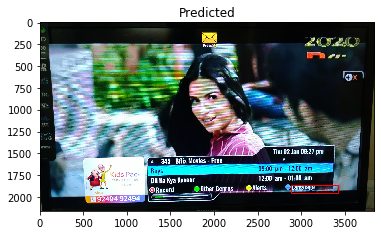

length of yhat[rois] :  2
len(yhat[rois]) more than 1 - Image no : 1


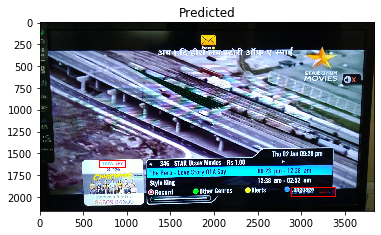

length of yhat[rois] :  2
len(yhat[rois]) more than 1 - Image no : 2


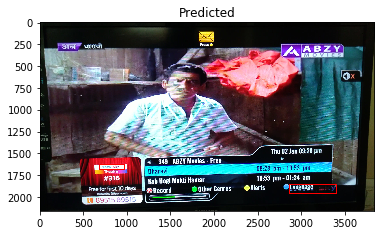

length of yhat[rois] :  2
len(yhat[rois]) more than 1 - Image no : 3


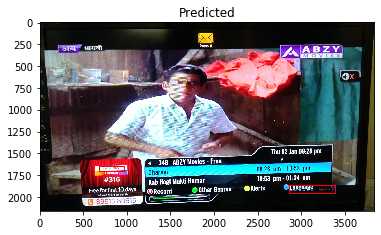

length of yhat[rois] :  2
len(yhat[rois]) more than 1 - Image no : 4


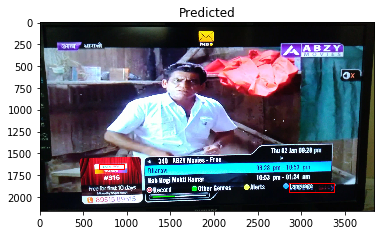

length of yhat[rois] :  1
len(yhat[rois]) is 1 - Image no : 5


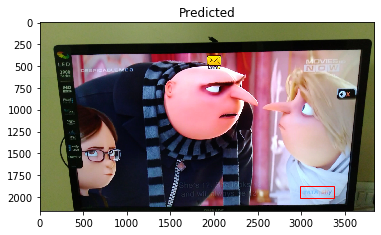

length of yhat[rois] :  1
len(yhat[rois]) is 1 - Image no : 6


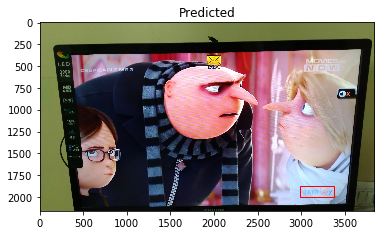

length of yhat[rois] :  1
len(yhat[rois]) is 1 - Image no : 7


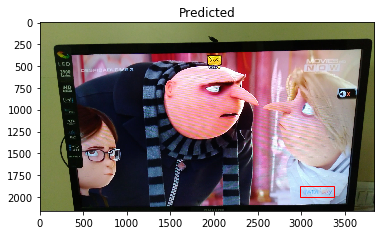

length of yhat[rois] :  1
len(yhat[rois]) is 1 - Image no : 8


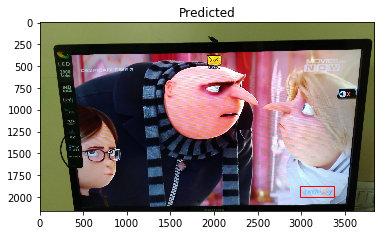

length of yhat[rois] :  2
len(yhat[rois]) more than 1 - Image no : 9


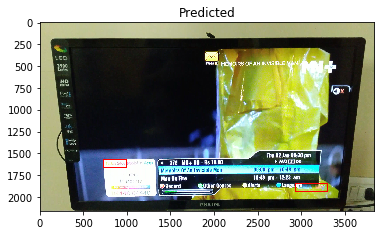

length of yhat[rois] :  2
len(yhat[rois]) more than 1 - Image no : 10


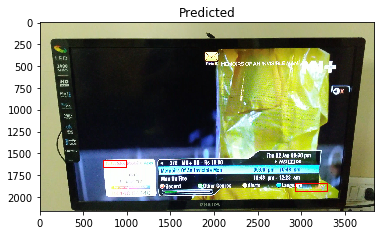

length of yhat[rois] :  2
len(yhat[rois]) more than 1 - Image no : 11


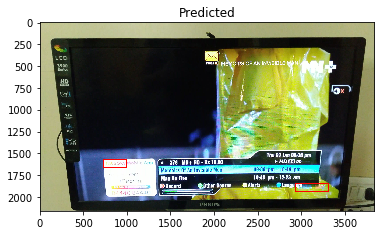

length of yhat[rois] :  2
len(yhat[rois]) more than 1 - Image no : 12


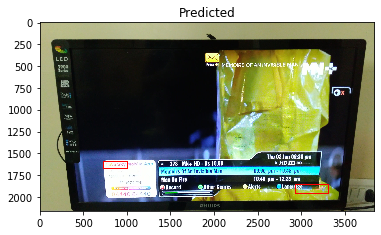

length of yhat[rois] :  2
len(yhat[rois]) more than 1 - Image no : 13


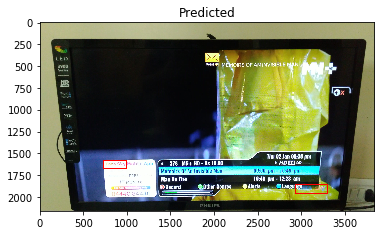

length of yhat[rois] :  2
len(yhat[rois]) more than 1 - Image no : 14


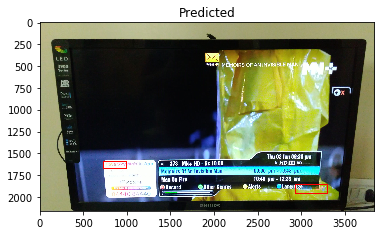

length of yhat[rois] :  2
len(yhat[rois]) more than 1 - Image no : 15


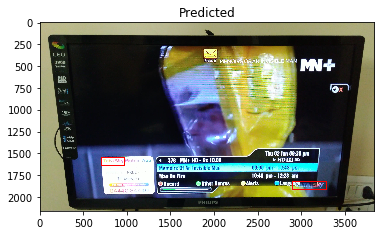

length of yhat[rois] :  2
len(yhat[rois]) more than 1 - Image no : 16


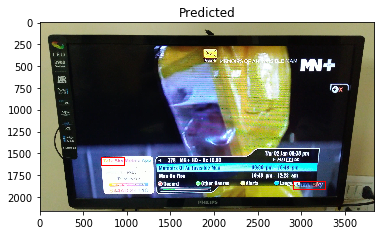

length of yhat[rois] :  2
len(yhat[rois]) more than 1 - Image no : 17


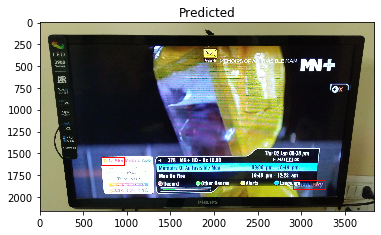

length of yhat[rois] :  2
len(yhat[rois]) more than 1 - Image no : 18


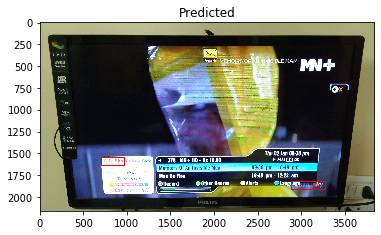

In [0]:
# evaluate the mask rcnn model on the TataSky dataset


# class that defines and loads the TataSky dataset
class TTSkyDataset(Dataset):
	# load the dataset definitions
	def load_dataset(self, dataset_dir, is_train=True):
		# define one class
		self.add_class("dataset", 1, "TTSky")
		# define data locations
		images_dir = dataset_dir + '/images/'
		annotations_dir = dataset_dir + '/annots/'
		# find all images
		for filename in listdir(images_dir):
			# extract image id
			image_id = filename[:-4]
			img_path = images_dir + filename
			ann_path = annotations_dir + image_id + '.xml'
			# add to dataset
			self.add_image('dataset', image_id=image_id, path=img_path, annotation=ann_path)


	# extract bounding boxes from an annotation file
	def extract_boxes(self, filename):
		# load and parse the file
		tree = ElementTree.parse(filename)
		# get the root of the document
		root = tree.getroot()
		# extract each bounding box
		boxes = list()
		for box in root.findall('.//bndbox'):
			xmin = int(box.find('xmin').text)
			ymin = int(box.find('ymin').text)
			xmax = int(box.find('xmax').text)
			ymax = int(box.find('ymax').text)
			coors = [xmin, ymin, xmax, ymax]
			boxes.append(coors)
		# extract image dimensions
		width = int(root.find('.//size/width').text)
		height = int(root.find('.//size/height').text)
		return boxes, width, height

	# load the masks for an image
	def load_mask(self, image_id):
		# get details of image
		info = self.image_info[image_id]
		# define box file location
		path = info['annotation']
		# load XML
		boxes, w, h = self.extract_boxes(path)
		# create one array for all masks, each on a different channel
		masks = zeros([h, w, len(boxes)], dtype='uint8')
		# create masks
		class_ids = list()
		for i in range(len(boxes)):
			box = boxes[i]
			row_s, row_e = box[1], box[3]
			col_s, col_e = box[0], box[2]
			masks[row_s:row_e, col_s:col_e, i] = 1
			class_ids.append(self.class_names.index('TTSky'))
		return masks, asarray(class_ids, dtype='int32')

	# load an image reference
	def image_reference(self, image_id):
		info = self.image_info[image_id]
		return info['path']

# define the prediction configuration
class TTSkyConfig(Config):
	# define the name of the configuration
	NAME = "TTSky_cfg"
	# number of classes (background + TTSky)
	NUM_CLASSES = 1 + 1
	# simplify GPU config
	GPU_COUNT = 1
	IMAGES_PER_GPU = 1

# training dataset - plot_actual_vs_predicted,  was commented out as Colab was running out of memory)
# # plot a number of photos with ground truth and predictions
# def plot_actual_vs_predicted(dataset, model, cfg, n_images=35):
# 	# load image and mask
# 	for i in range(n_images):
# 		# load the image and mask
# 		image = dataset.load_image(i)
# 		mask, _ = dataset.load_mask(i)
# 		# convert pixel values (e.g. center)
# 		scaled_image = mold_image(image, cfg)
# 		# convert image into one sample
# 		sample = expand_dims(scaled_image, 0)
# 		# make prediction
# 		yhat = model.detect(sample, verbose=0)[0]
# 		# define subplot
# 		pyplot.subplot(n_images, 2, i*2+1)
# 		# plot raw pixel data
# 		pyplot.imshow(image)
# 		pyplot.title('Actual')
# 		# plot masks
# 		for j in range(mask.shape[2]):
# 			pyplot.imshow(mask[:, :, j], cmap='gray', alpha=0.3)
# 		# get the context for drawing boxes
# 		pyplot.subplot(n_images, 2, i*2+2)
# 		# plot raw pixel data
# 		pyplot.imshow(image)
# 		pyplot.title('Predicted')
# 		ax = pyplot.gca()
# 		# plot each box
# 		for box in yhat['rois']:
# 			# get coordinates
# 			y1, x1, y2, x2 = box
# 			# calculate width and height of the box
# 			width, height = x2 - x1, y2 - y1
# 			# create the shape
# 			rect = Rectangle((x1, y1), width, height, fill=False, color='red')
# 			# draw the box
# 			ax.add_patch(rect)
# 			image_id = random.choice(dataset.image_ids)
# 			image_id = random.choice(dataset.image_ids)
# 			original_image, image_meta, gt_class_id, gt_bbox, gt_mask =\
#     	modellib.load_image_gt(dataset, cfg,
#                            image_id, use_mini_mask=False)
# 			log("original_image",original_image)
# 			log("image_meta",image_meta)
# 			log("gt_class_id",gt_class_id)
# 			# log("gt_box",gt_box)
# 			log("gt_mask",gt_mask)

# 			display_instances(original_image,gt_bbox,gt_mask,gt_class_id,dataset.class_names,figsize=(8,8))

		# show the figure
		# cv2_imshow()
		# display_instances(image, bbox, mask, class_ids, dataset.class_names)
		# pyplot.savefig('Actual{}.png'.format(i), format='png', dpi=1200) #dpi=500)
		# pyplot.show()

# plot a number of photos with ground truth and predictions
def plot_actual_vs_predicted(dataset, model, cfg, n_images):
	# load image and mask
	for i in range(n_images):
		# load the image and mask
		image = dataset.load_image(i)
		mask, _ = dataset.load_mask(i)
		# info = train_set.image_info[image]
		# print('test image info',info)
		# convert pixel values (e.g. center)
		scaled_image = mold_image(image, cfg)
		# convert image into one sample
		sample = expand_dims(scaled_image, 0)
		# make prediction
		yhat = model.detect(sample, verbose=0)[0]
		# # define subplot
		# pyplot.subplot(n_images, 2, i*2+1)
		# # plot raw pixel data
		# pyplot.imshow(image)
		# pyplot.title('Actual')
		# # plot masks
		# for j in range(mask.shape[2]):
		# 	pyplot.imshow(mask[:, :, j], cmap='gray', alpha=0.3)
		# get the context for drawing boxes
		# pyplot.subplot(n_images, 2, i*2+2)
		# plot raw pixel data
		pyplot.imshow(image)
		pyplot.title('Predicted')
		ax = pyplot.gca()
		# plot each box
		print('length of yhat[rois] : ',len(yhat['rois']))
		if len(yhat['rois']) == 1:
			for box in yhat['rois']:
				# get coordinates
				y1, x1, y2, x2 = box
				# calculate width and height of the box
				width, height = x2 - x1, y2 - y1
				# create the shape
				rect = Rectangle((x1, y1), width, height, fill=False, color='red')
				# draw the box
				ax.add_patch(rect)
				print('len(yhat[rois]) is 1 - Image no :',i)
				pyplot.savefig('/content/drive/My Drive/Colab Notebooks/Task_Assign/Predicted_images/Predicted_TTSky_{}.png'.format(i), format='png', dpi=1200)
				pyplot.show()
		else:
			for x in range(len(yhat['rois'])):
				for box in yhat['rois']:
					# get coordinates
					y1, x1, y2, x2 = box
					# calculate width and height of the box
					width, height = x2 - x1, y2 - y1
					# create the shape
					rect = Rectangle((x1, y1), width, height, fill=False, color='red')
					# draw the box
					ax.add_patch(rect)
			print('len(yhat[rois]) more than 1 - Image no :',i)
			pyplot.savefig('/content/drive/My Drive/Colab Notebooks/Task_Assign/Predicted_images/Predicted_TTSky_{}.png'.format(i), format='png', dpi=1200)
			pyplot.show()
	# show the figure
	# pyplot.savefig('Actual_{}.png'.format(i), format='png', dpi=1200)
	# pyplot.show()	


train_ref_path = '/content/drive/My Drive/Colab Notebooks/Task_Assign/TTsky/Train'
test_ref_path =  '/content/drive/My Drive/Colab Notebooks/Task_Assign/TTsky/Test'

# load the train dataset
# train_set = InletDataset()
# train_set.load_dataset(train_ref_path, is_train=True)
# train_set.prepare()
# print('Train: %d' % len(train_set.image_ids))
# load the test dataset
test_set = TTSkyDataset()
test_set.load_dataset(test_ref_path, is_train=False)
test_set.prepare()
test_image_len = len(test_set.image_ids)
print('Test: %d' % len(test_set.image_ids))

# create config
cfg = TTSkyConfig()
# define the model
model = MaskRCNN(mode='inference', model_dir='./', config=cfg)
# load model weights
model_path = '/content/ttsky_cfg20200210T0614/mask_rcnn_ttsky_cfg_0150.h5'
model.load_weights(model_path, by_name=True)
# plot predictions for train dataset
# plot_actual_vs_predicted(train_set, model, cfg)
# plot predictions for test dataset
plot_actual_vs_predicted(test_set, model, cfg,test_image_len)

## # Below is the code for cropping the tatasky logo with predicted bounding box coordinates

In [0]:
# Below is the code for cropping the tatasky logo with predicted bounding box coordinates
def crop_image(Tatasky_pred_coor,img_name):
	df = pd.DataFrame(list(zip(inlet_pred_coor,img_name)),columns = ['Image_Name','Pred_cord'])
	for i in range(len(df)):  
		save_loc = '/content/drive/My Drive/Colab Notebooks/Single_image_model/Predicted_image_Inlet/cropped_{}.png'.format(df.iloc[i,1])
		im = cv2.imread(r"/content/drive/My Drive/Colab Notebooks/Single_image_model/Inlet_final_data/Test/images/{}".format(df.iloc[i,1]))
    
		if len(df.iloc[i,0]) == 0:
			print('image_id for no detection',df.iloc[i,1])
			continue
		elif len(df.iloc[i,0]) == 1:
			print('image_id for 1 detection',df.iloc[i,1])
			cord = df.iloc[i,0][0]
			xmin,ymin, xmax,ymax = cord[0],cord[1],cord[2],cord[3]
			ymin = int(ymin-(ymin*0.5)) # Adding few more pixel for the y-cordinate in case some part of the logo is cropped
			roi = im[xmin:xmax,ymin:ymax]
			cv2.imwrite(r"Location/cropped_Tatasky_{}.png".format(i), roi)
		else:
			for j in range(len(df.iloc[i,0])):
				print('image_id for more than 1 detection',df.iloc[i,1])
				xmin = inlet_pred_coor[i][j][0]
				ymin = inlet_pred_coor[i][j][1]
				xmax = inlet_pred_coor[i][j][2]
				ymax = inlet_pred_coor[i][j][3]
				print(xmin,ymin,xmax,ymax)
				ymin = int(ymin-(ymin*0.5))
				roi = im[xmin:xmax,ymin:ymax]
				cv2.imwrite(r"Location/cropped_Tatasky_{}.png".format(i,j), roi)


## # For running the below code need to return 'Tatasky_pred_coor,img_name' parameter value from the method plot_actual_vs_predicted

In [0]:

Tatasky_pred_coor,img_name = plot_actual_vs_predicted(test_set, model, cfg,test_image_len)
# Calling cropped image function, for corping and storing at directory
crop_image(Tatasky_pred_coor,img_name)